# Hierachical Multivariate Time Series User Classification
##### Using "gaze-path" and pupil dilation data; 33% of the total collected.

#### DEPENDENCIES AND METHODS

In [1]:
!pip install --quiet pytorch-lightning
!pip install --quiet seaborn

     |████████████████████████████████| 705 kB 30.2 MB/s 
     |████████████████████████████████| 419 kB 71.8 MB/s 
     |████████████████████████████████| 5.9 MB 60.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.


In [2]:
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import json
import plotly.graph_objects as go
import pandas as pd
import torch
import pytorch_lightning as pl
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from tqdm import tqdm
from IPython.display import HTML
from sklearn.preprocessing import LabelEncoder
from os import cpu_count, environ

import torch.autograd as autograd
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn.modules import dropout

from multiprocessing import cpu_count
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from torchmetrics.functional import accuracy
from sklearn.metrics import classification_report, confusion_matrix


pl.seed_everything(42)

float_formatter = "{:.8f}".format
np.set_printoptions(formatter={'float_kind':float_formatter})


def print_yellow(text): print("\033[93m {}\033[00m".format(text))


def print_bold(text): print(f"\033[1m {text} \033[0m")


def read_json(path):
  with open(path, 'r') as file_in:
     return json.load(file_in)


def str2listf(l):
    l = l.replace("[", "")
    l = l.replace("]", "")
    l = l.replace("\n", "")
    l = l.split(', ')
    l = [float(i) for i in l]
    return l


def max_listoflists_lenght(l, verbose=False):
  """l is a list of lists"""
  max_lenght = 0
  for i in l:
    if max_lenght < len(i):
      max_lenght = len(i)
  if verbose:
    print("min_lenght: ", min_listoflists_lenght(l))
    print("max_lenght: ", max_lenght)
  return max_lenght


def min_listoflists_lenght(l):
  """l is a list of lists"""
  min_lenght = 999999
  for i in l:
    if min_lenght > len(i):
      min_lenght = len(i)
  return min_lenght


def normalize(l, verbose=False):
  l = (l - np.mean(l)) / np.std(l)
  l = [i.tolist() for i in l]
  if verbose:
    print("max: ", max(l))
    print("mean: ", np.mean(l))
    print("std: ", np.std(l))
  return l


def normalize_lenghts(l, verbose=False, max_lenght=0):
  """l is a list of lists"""
  if max_lenght==0:
    max_lenght = max_listoflists_lenght(l, verbose)
  print("max_lenght: ", max_lenght)
  new_l = [np.interp(np.linspace(0, 1, max_lenght).astype('float'), np.linspace(0, 1, len(l_i)).astype('float'), l_i) for l_i in l]
  if verbose:
    min_listoflists_lenght(l)
  return new_l


def normalize_single_lenght(l, max_lenght=0):
  """l is a list"""
  if max_lenght==0:
    max_lenght = max([len(i) for i in l])
  print("max_lenght: ", max_lenght)
  new_l = np.interp(np.linspace(0, 1, max_lenght).astype('float'), np.linspace(0, 1, len(l)).astype('float'), l)
  return new_l


def add_pattern_name_to_ts(distance_ts, pupil_ts):
  new_pupil_ts = []
  for distance, pupil in zip(distance_ts, pupil_ts):
    pattern_name, _ = distance
    new_pupil_ts.append([pattern_name, pupil])
  return new_pupil_ts


def get_distance_in_dataframe(df, user_name):
  is_user = df['participant_name'] == user_name
  df = df[is_user]
  distance_collection = []
  
  for ix, sample in df.iterrows():
    # print(sample)
    try:
      distance_collection.append([sample['pattern_name'], sample['ts_distance'].tolist()])
    except AttributeError:
      distance_collection.append([sample['pattern_name'], sample['ts_distance']])
  return distance_collection


def get_pupil_in_dataframe(df, user_name):
  is_user = df['participant_name'] == user_name
  df = df[is_user]
  pupil_collection = []

  for ix, sample in df.iterrows():
    try:
      pupil_collection.append([sample['pattern_name'], sample['ts_pupil'].tolist()])
    except AttributeError:
      pupil_collection.append([sample['pattern_name'], sample['ts_pupil']])
  return pupil_collection 
  

def plot_collection(plot_only_this:str, distances_collection,
                    number_of_desired_plots=0):
  
  """this method takes the distances_collection for one user and a specific 
      pattern plot_only_this and add traces in the same graph until the 
      number_of_desired_plots is reached; if 0 then plot all"""

      # todo: there is a lot of redundancy, you could clear a lot of lines

  fig = go.Figure()
  plots_count = 0
  print("total number of graphs: ", len(distances_collection))

  for (pattern_name, d) in distances_collection:
    if pattern_name == plot_only_this:
      if plots_count ==0:
        fig.add_trace(go.Line(y=d))
        fig.update_layout(title=plot_only_this)
      else:
        fig.add_trace(go.Line(y=d))
      plots_count += 1
      fig.update_layout(width=1200, height=800)
      if number_of_desired_plots:
        if plots_count == number_of_desired_plots:
          break

  print("plots: ", plots_count)
  return fig 


def plot_user_compare(plot_only_this:str, distances_collection, labels,
                    number_of_desired_plots=0):
  
  """this method takes the distances_collection for one user and a specific 
      pattern plot_only_this and add traces in the same graph until the 
      number_of_desired_plots is reached; if 0 then plot all"""

      # todo: there is a lot of redundancy, you could clear a lot of lines

  fig = go.Figure()
  plots_count = 0
  print("total number of graphs: ", len(distances_collection))

  for (pattern_name, d), name in zip(distances_collection, labels):
    if pattern_name == plot_only_this:
      if plots_count ==0:
        fig.add_trace(go.Line(y=d, name=name))
        fig.update_layout(title=plot_only_this)
      else:
        fig.add_trace(go.Line(y=d, name=name))
      plots_count += 1
      fig.update_layout(width=1200, height=800)
      if number_of_desired_plots:
        if plots_count == number_of_desired_plots:
          break

  print("plots: ", plots_count)
  return fig 


def plot_experiment(name:str, l, normal=False, normal_only=False, stretched=False, max_lenght=0, verbose=False):
  if verbose:
    print("raw: ")
    print("max: ", max(l))
    print("mean: ", np.mean(l))
    print("std: ", np.std(l), end="\n\n")
    
  fig = go.Figure()
  fig.update_layout(title=name)
  fig.update_layout(width=1200, height=800)
  if not normal_only:
    fig.add_trace(go.Line(name="raw", y=l))

  if normal:
    l_normal = normalize(l, verbose=verbose)
    fig.add_trace(go.Line(name="nomalized_value", y=l_normal))

  if stretched:
    if max_lenght!=0:
      l_normal = normalize_single_lenght(l, max_lenght=max_lenght)
    else:
      l_normal = normalize_single_lenght(l)
    fig.add_trace(go.Line(name="nomalized_lenght", y=l_normal))
      
  return fig


def show_confusion_matrix(confusion_matrix):
  hmap = sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Blues")
  hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right')
  hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')
  plt.ylabel('True User')
  plt.xlabel('Predicted User')

INFO:pytorch_lightning.utilities.seed:Global seed set to 42


#### DATA

In [10]:
PARTICIPANTS = ["Anoth", "Arif", "Ashok", "Gowthom", "Josephin", "Raghu", "Sebastian"]

In [11]:
# read dataframe
df_concat = pd.read_csv('./data_ready.csv')
df_concat

,Unnamed: 0,participant_name,pattern_name,ts_distance,ts_pupil,x_coord,y_coord,series_original_lenght
0,0,Anoth,pattern3,"[0.028, 0.028, 0.028, 0.028, 0.028, 0.028, 0.0...","[3.554, 3.554, 3.554, 3.5516, 3.5475, 3.5435, ...","[0.278, 0.278, 0.278, 0.278, 0.278, 0.278, 0.2...","[0.136, 0.136, 0.136, 0.136, 0.136, 0.136, 0.1...",67
1,1,Anoth,pattern6,"[0.012, 0.0111, 0.0103, 0.0094, 0.0085, 0.0074...","[3.382, 3.3816, 3.3811, 3.3826, 3.3847, 3.3873...","[0.277, 0.277, 0.277, 0.277, 0.277, 0.2776, 0....","[0.138, 0.1389, 0.1398, 0.1406, 0.1415, 0.1426...",71
2,2,Anoth,pattern1,"[0.031, 0.0303, 0.0296, 0.0289, 0.0279, 0.0268...","[2.991, 2.9937, 2.9965, 2.9987, 2.9952, 2.9918...","[0.278, 0.2783, 0.2787, 0.279, 0.2794, 0.2797,...","[0.119, 0.1197, 0.1204, 0.1211, 0.1221, 0.1232...",56
3,3,Anoth,pattern3,"[0.025, 0.0254, 0.0258, 0.0258, 0.0254, 0.025,...","[3.175, 3.1762, 3.1775, 3.1768, 3.1747, 3.1724...","[0.275, 0.2754, 0.2758, 0.2758, 0.2754, 0.275,...","[0.129, 0.129, 0.129, 0.1288, 0.1283, 0.128, 0...",67
4,4,Anoth,pattern4,"[0.005, 0.0053, 0.0057, 0.006, 0.007, 0.008, 0...","[3.386, 3.387, 3.388, 3.389, 3.3906, 3.3923, 3...","[0.29, 0.2887, 0.2873, 0.286, 0.2857, 0.2853, ...","[0.145, 0.1447, 0.1443, 0.144, 0.143, 0.142, 0...",54
...,...,...,...,...,...,...,...,...
619,625,Sebastian,pattern5,"[0.018, 0.0175, 0.0171, 0.0166, 0.0161, 0.0168...","[3.022, 3.021, 3.0201, 3.0204, 3.0209, 3.0202,...","[0.26, 0.2605, 0.261, 0.261, 0.261, 0.2618, 0....","[0.133, 0.1344, 0.1358, 0.1364, 0.1369, 0.1374...",77
620,626,Sebastian,pattern1,"[0.007, 0.0073, 0.0077, 0.008, 0.0076, 0.0073,...","[2.976, 2.9791, 2.9822, 2.9852, 2.9876, 2.99, ...","[0.262, 0.2617, 0.2613, 0.261, 0.2614, 0.2617,...","[0.143, 0.1427, 0.1423, 0.142, 0.1424, 0.1427,...",56
621,627,Sebastian,pattern6,"[0.005, 0.005, 0.005, 0.0045, 0.0037, 0.0031, ...","[3.13, 3.1333, 3.1366, 3.1394, 3.1419, 3.1439,...","[0.265, 0.2658, 0.2666, 0.267, 0.267, 0.2669, ...","[0.145, 0.145, 0.145, 0.1455, 0.1463, 0.1469, ...",67
622,628,Sebastian,pattern3,"[0.018, 0.0175, 0.017, 0.0165, 0.016, 0.018, 0...","[3.09, 3.0905, 3.091, 3.0895, 3.088, 3.0885, 3...","[0.268, 0.2675, 0.267, 0.2665, 0.266, 0.268, 0...","[0.144, 0.1445, 0.145, 0.144, 0.143, 0.143, 0....",81


In [12]:
# change datatypes

# del unnamed and make it the index
df_concat.index = df_concat['Unnamed: 0'].tolist()
del df_concat['Unnamed: 0']

# cast values from string to float
df_concat.ts_distance = df_concat.ts_distance.apply(str2listf)
df_concat.ts_pupil = df_concat.ts_pupil.apply(str2listf)
df_concat.x_coord = df_concat.x_coord.apply(str2listf)
df_concat.y_coord = df_concat.y_coord.apply(str2listf)
df_concat['series_original_lenght'] = df_concat['series_original_lenght'].apply(lambda i: int(i))
df_concat

,participant_name,pattern_name,ts_distance,ts_pupil,x_coord,y_coord,series_original_lenght
0,Anoth,pattern3,"[0.028, 0.028, 0.028, 0.028, 0.028, 0.028, 0.0...","[3.554, 3.554, 3.554, 3.5516, 3.5475, 3.5435, ...","[0.278, 0.278, 0.278, 0.278, 0.278, 0.278, 0.2...","[0.136, 0.136, 0.136, 0.136, 0.136, 0.136, 0.1...",67
1,Anoth,pattern6,"[0.012, 0.0111, 0.0103, 0.0094, 0.0085, 0.0074...","[3.382, 3.3816, 3.3811, 3.3826, 3.3847, 3.3873...","[0.277, 0.277, 0.277, 0.277, 0.277, 0.2776, 0....","[0.138, 0.1389, 0.1398, 0.1406, 0.1415, 0.1426...",71
2,Anoth,pattern1,"[0.031, 0.0303, 0.0296, 0.0289, 0.0279, 0.0268...","[2.991, 2.9937, 2.9965, 2.9987, 2.9952, 2.9918...","[0.278, 0.2783, 0.2787, 0.279, 0.2794, 0.2797,...","[0.119, 0.1197, 0.1204, 0.1211, 0.1221, 0.1232...",56
3,Anoth,pattern3,"[0.025, 0.0254, 0.0258, 0.0258, 0.0254, 0.025,...","[3.175, 3.1762, 3.1775, 3.1768, 3.1747, 3.1724...","[0.275, 0.2754, 0.2758, 0.2758, 0.2754, 0.275,...","[0.129, 0.129, 0.129, 0.1288, 0.1283, 0.128, 0...",67
4,Anoth,pattern4,"[0.005, 0.0053, 0.0057, 0.006, 0.007, 0.008, 0...","[3.386, 3.387, 3.388, 3.389, 3.3906, 3.3923, 3...","[0.29, 0.2887, 0.2873, 0.286, 0.2857, 0.2853, ...","[0.145, 0.1447, 0.1443, 0.144, 0.143, 0.142, 0...",54
...,...,...,...,...,...,...,...
625,Sebastian,pattern5,"[0.018, 0.0175, 0.0171, 0.0166, 0.0161, 0.0168...","[3.022, 3.021, 3.0201, 3.0204, 3.0209, 3.0202,...","[0.26, 0.2605, 0.261, 0.261, 0.261, 0.2618, 0....","[0.133, 0.1344, 0.1358, 0.1364, 0.1369, 0.1374...",77
626,Sebastian,pattern1,"[0.007, 0.0073, 0.0077, 0.008, 0.0076, 0.0073,...","[2.976, 2.9791, 2.9822, 2.9852, 2.9876, 2.99, ...","[0.262, 0.2617, 0.2613, 0.261, 0.2614, 0.2617,...","[0.143, 0.1427, 0.1423, 0.142, 0.1424, 0.1427,...",56
627,Sebastian,pattern6,"[0.005, 0.005, 0.005, 0.0045, 0.0037, 0.0031, ...","[3.13, 3.1333, 3.1366, 3.1394, 3.1419, 3.1439,...","[0.265, 0.2658, 0.2666, 0.267, 0.267, 0.2669, ...","[0.145, 0.145, 0.145, 0.1455, 0.1463, 0.1469, ...",67
628,Sebastian,pattern3,"[0.018, 0.0175, 0.017, 0.0165, 0.016, 0.018, 0...","[3.09, 3.0905, 3.091, 3.0895, 3.088, 3.0885, 3...","[0.268, 0.2675, 0.267, 0.2665, 0.266, 0.268, 0...","[0.144, 0.1445, 0.145, 0.144, 0.143, 0.143, 0....",81


#### PLOTS: ORIGINAL AND VALUE_NORM

In [8]:
josephin_pupil = get_pupil_in_dataframe(df_concat, "Josephin")
HTML(plot_collection("pattern1", josephin_pupil).to_html())
# interesting that the value changes with the attempt number. so perhaps a normalization per value for pupil will help

# I could add column of max value per series (row) so I can detect outliers there too...

total number of graphs:  89
plots:  15


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [36]:
# after normalization by value
josephin_pupil = get_pupil_in_dataframe(df_concat, "Josephin")
HTML(plot_collection("pattern1", josephin_pupil).to_html())

total number of graphs:  89
plots:  15


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [9]:
# todo: clean the data series from 0.0 measures (blinking, device error, ...)
josephin_distance = get_distance_in_dataframe(df_concat, "Josephin")
HTML(plot_collection("pattern1", josephin_distance).to_html())

total number of graphs:  89
plots:  15


#### NORMALIZATION

In [13]:
# check lenghts of series for each row

print_bold("checking sequence lenghts matching...\n")

# for ix, (d, p) in enumerate(zip(df_concat['ts_distance'], df_concat['ts_pupil'])):
#   print(f"lenght of sequence in ts_distance: {len(d)}, lenght of sequence in ts_pupil: {len(p)}", end=" ")
#   print_bold(len(d)==len(p))


print("\nmin lenght in ts_distance = ", min_listoflists_lenght(df_concat['ts_distance'].tolist()))
print("min lenght in ts_pupil = ", min_listoflists_lenght(df_concat['ts_pupil'].tolist()))
print("max lenght in ts_distance = ", max_listoflists_lenght(df_concat['ts_distance'].tolist()))
print("max lenght in ts_pupil = ", max_listoflists_lenght(df_concat['ts_pupil'].tolist()))
print("max lenght in x_coord = ", max_listoflists_lenght(df_concat['x_coord'].tolist()))
print("max lenght in y_coord = ", max_listoflists_lenght(df_concat['y_coord'].tolist()))

 checking sequence lenghts matching...
 

min lenght in ts_distance =  161
min lenght in ts_pupil =  161
max lenght in ts_distance =  161
max lenght in ts_pupil =  161
max lenght in x_coord =  161
max lenght in y_coord =  161


In [14]:
# Normalize ALL (also by lenght)

# df_concat.ts_distance = df_concat.ts_distance.apply(normalize)
# df_concat.ts_distance = normalize_lenghts(df_concat.ts_distance.tolist())

# df_concat.ts_pupil = df_concat.ts_pupil.apply(normalize)
# df_concat.ts_pupil = normalize_lenghts(df_concat.ts_pupil.tolist(), max_lenght=max_listoflists_lenght(df_concat['ts_distance']))

df_concat

,participant_name,pattern_name,ts_distance,ts_pupil,x_coord,y_coord,series_original_lenght
0,Anoth,pattern3,"[0.028, 0.028, 0.028, 0.028, 0.028, 0.028, 0.0...","[3.554, 3.554, 3.554, 3.5516, 3.5475, 3.5435, ...","[0.278, 0.278, 0.278, 0.278, 0.278, 0.278, 0.2...","[0.136, 0.136, 0.136, 0.136, 0.136, 0.136, 0.1...",67
1,Anoth,pattern6,"[0.012, 0.0111, 0.0103, 0.0094, 0.0085, 0.0074...","[3.382, 3.3816, 3.3811, 3.3826, 3.3847, 3.3873...","[0.277, 0.277, 0.277, 0.277, 0.277, 0.2776, 0....","[0.138, 0.1389, 0.1398, 0.1406, 0.1415, 0.1426...",71
2,Anoth,pattern1,"[0.031, 0.0303, 0.0296, 0.0289, 0.0279, 0.0268...","[2.991, 2.9937, 2.9965, 2.9987, 2.9952, 2.9918...","[0.278, 0.2783, 0.2787, 0.279, 0.2794, 0.2797,...","[0.119, 0.1197, 0.1204, 0.1211, 0.1221, 0.1232...",56
3,Anoth,pattern3,"[0.025, 0.0254, 0.0258, 0.0258, 0.0254, 0.025,...","[3.175, 3.1762, 3.1775, 3.1768, 3.1747, 3.1724...","[0.275, 0.2754, 0.2758, 0.2758, 0.2754, 0.275,...","[0.129, 0.129, 0.129, 0.1288, 0.1283, 0.128, 0...",67
4,Anoth,pattern4,"[0.005, 0.0053, 0.0057, 0.006, 0.007, 0.008, 0...","[3.386, 3.387, 3.388, 3.389, 3.3906, 3.3923, 3...","[0.29, 0.2887, 0.2873, 0.286, 0.2857, 0.2853, ...","[0.145, 0.1447, 0.1443, 0.144, 0.143, 0.142, 0...",54
...,...,...,...,...,...,...,...
625,Sebastian,pattern5,"[0.018, 0.0175, 0.0171, 0.0166, 0.0161, 0.0168...","[3.022, 3.021, 3.0201, 3.0204, 3.0209, 3.0202,...","[0.26, 0.2605, 0.261, 0.261, 0.261, 0.2618, 0....","[0.133, 0.1344, 0.1358, 0.1364, 0.1369, 0.1374...",77
626,Sebastian,pattern1,"[0.007, 0.0073, 0.0077, 0.008, 0.0076, 0.0073,...","[2.976, 2.9791, 2.9822, 2.9852, 2.9876, 2.99, ...","[0.262, 0.2617, 0.2613, 0.261, 0.2614, 0.2617,...","[0.143, 0.1427, 0.1423, 0.142, 0.1424, 0.1427,...",56
627,Sebastian,pattern6,"[0.005, 0.005, 0.005, 0.0045, 0.0037, 0.0031, ...","[3.13, 3.1333, 3.1366, 3.1394, 3.1419, 3.1439,...","[0.265, 0.2658, 0.2666, 0.267, 0.267, 0.2669, ...","[0.145, 0.145, 0.145, 0.1455, 0.1463, 0.1469, ...",67
628,Sebastian,pattern3,"[0.018, 0.0175, 0.017, 0.0165, 0.016, 0.018, 0...","[3.09, 3.0905, 3.091, 3.0895, 3.088, 3.0885, 3...","[0.268, 0.2675, 0.267, 0.2665, 0.266, 0.268, 0...","[0.144, 0.1445, 0.145, 0.144, 0.143, 0.143, 0....",81


#### FEATURE SELECTION

In [15]:
# FEATURE SELECTION --> EXPLODE THE DATAFRAME TS_DISTANCE AND TS_PUPIL

for ix, series in tqdm(df_concat.iterrows(), total=len(df_concat)):
  series_df_base = pd.DataFrame(series.ts_distance, columns=["trace_difference"])

  series_df_pupil = pd.DataFrame(series.ts_pupil, columns=["pupil_diameter"])
  series_df_xcoord = pd.DataFrame(series.x_coord, columns=["x_coord"])
  series_df_ycoord = pd.DataFrame(series.y_coord, columns=["y_coord"])

  series_df_base["pupil_diameter"] = series_df_pupil['pupil_diameter']
  series_df_base["x_coord"] = series_df_xcoord['x_coord']
  series_df_base["y_coord"] = series_df_ycoord['y_coord']
  series_df_base["participant_name"] = series.participant_name
  series_df_base["pattern_name"] = series.pattern_name
  series_df_base["series_original_lenght"] = series.series_original_lenght
  series_df_base["series_id"] = ix

  series_df_base = series_df_base[["participant_name", "pattern_name", "series_id", "trace_difference", "pupil_diameter", "x_coord", "y_coord", "series_original_lenght"]]

  df_exploted = series_df_base if ix==0 else pd.concat([df_exploted, series_df_base])

df_exploted

100%|██████████| 624/624 [00:05<00:00, 113.75it/s]


,participant_name,pattern_name,series_id,trace_difference,pupil_diameter,x_coord,y_coord,series_original_lenght
0,Anoth,pattern3,0,0.0280,3.5540,0.2780,0.1360,67
1,Anoth,pattern3,0,0.0280,3.5540,0.2780,0.1360,67
2,Anoth,pattern3,0,0.0280,3.5540,0.2780,0.1360,67
3,Anoth,pattern3,0,0.0280,3.5516,0.2780,0.1360,67
4,Anoth,pattern3,0,0.0280,3.5475,0.2780,0.1360,67
...,...,...,...,...,...,...,...,...
156,Sebastian,pattern4,629,0.0024,3.1917,0.6556,0.8524,67
157,Sebastian,pattern4,629,0.0041,3.2090,0.6622,0.8540,67
158,Sebastian,pattern4,629,0.0046,3.2186,0.6728,0.8547,67
159,Sebastian,pattern4,629,0.0038,3.2178,0.6889,0.8538,67


In [16]:
# encode pattern_name using LabelEncoder()

pattern_encoder = LabelEncoder()

encoded_patterns = pattern_encoder.fit_transform(df_exploted.pattern_name)
print({k:v for k, v in zip(pattern_encoder.classes_.tolist(), set(encoded_patterns))})

{'pattern1': 0, 'pattern2': 1, 'pattern3': 2, 'pattern4': 3, 'pattern5': 4, 'pattern6': 5}


In [17]:
df_exploted["pattern_id"] = encoded_patterns
# df_exploted.reset_index(inplace=True)
df_exploted

,participant_name,pattern_name,series_id,trace_difference,pupil_diameter,x_coord,y_coord,series_original_lenght,pattern_id
0,Anoth,pattern3,0,0.0280,3.5540,0.2780,0.1360,67,2
1,Anoth,pattern3,0,0.0280,3.5540,0.2780,0.1360,67,2
2,Anoth,pattern3,0,0.0280,3.5540,0.2780,0.1360,67,2
3,Anoth,pattern3,0,0.0280,3.5516,0.2780,0.1360,67,2
4,Anoth,pattern3,0,0.0280,3.5475,0.2780,0.1360,67,2
...,...,...,...,...,...,...,...,...,...
156,Sebastian,pattern4,629,0.0024,3.1917,0.6556,0.8524,67,3
157,Sebastian,pattern4,629,0.0041,3.2090,0.6622,0.8540,67,3
158,Sebastian,pattern4,629,0.0046,3.2186,0.6728,0.8547,67,3
159,Sebastian,pattern4,629,0.0038,3.2178,0.6889,0.8538,67,3


In [18]:
# filter dfs selecting the desired features

FEATURES = ["trace_difference", "pupil_diameter", "x_coord", "y_coord", "series_original_lenght", "pattern_id"]
PREDICTION_TARGET = "participant_name"

y = df_exploted[["series_id", "pattern_id", "participant_name"]]
y = y[["series_id", PREDICTION_TARGET]]

X_columns = ["series_id"]  # this is important for LSTMs
X_columns.extend(FEATURES)
X = df_exploted[X_columns]

y.reset_index(inplace=True)
del y["index"]
X.reset_index(inplace=True)
del X["index"]

print(f"\nX: {len(X)}; y: {len(y)}; equal? {len(X)==len(y)}")

X


X: 100464; y: 100464; equal? True


,series_id,trace_difference,pupil_diameter,x_coord,y_coord,series_original_lenght,pattern_id
0,0,0.0280,3.5540,0.2780,0.1360,67,2
1,0,0.0280,3.5540,0.2780,0.1360,67,2
2,0,0.0280,3.5540,0.2780,0.1360,67,2
3,0,0.0280,3.5516,0.2780,0.1360,67,2
4,0,0.0280,3.5475,0.2780,0.1360,67,2
...,...,...,...,...,...,...,...
100459,629,0.0024,3.1917,0.6556,0.8524,67,3
100460,629,0.0041,3.2090,0.6622,0.8540,67,3
100461,629,0.0046,3.2186,0.6728,0.8547,67,3
100462,629,0.0038,3.2178,0.6889,0.8538,67,3


In [19]:
# print(f"\nConsidering {len(PARTICIPANTS)} participants with {len(anoth_distance)} experiments each, we have {len(PARTICIPANTS) * len(anoth_distance)} number of samples or single graphs.\n\
# Naturally the lenght of the time-series for a single experiment is dependent on the speed of the user at that pattern attempt. \n\
# The absolute minimum lenght for this data collection is {min_listoflists_lenght(df_concat.ts_distance.tolist())} and the maximum {max_listoflists_lenght(df_concat.ts_distance.tolist())}. \n\
# After normalization, all time series have the same lenght: {max_listoflists_lenght(df_concat.ts_distance.tolist())}. \n\
# Therefore, each equal-lenght time series (one single row) can be exploded into {max_listoflists_lenght(df_concat.ts_distance.tolist())} rows. \n\
# In order to identify the original row index before exploding, a new column 'series_id' is added to de dataframe. \n\
# Ergo, the total number of samples for my new dataframes X and y is {len(PARTICIPANTS) * len(anoth_distance) * max_listoflists_lenght(df_concat.ts_distance.tolist())}.")

In [20]:
y

,series_id,participant_name
0,0,Anoth
1,0,Anoth
2,0,Anoth
3,0,Anoth
4,0,Anoth
...,...,...
100459,629,Sebastian
100460,629,Sebastian
100461,629,Sebastian
100462,629,Sebastian


#### PATTERN DEPENDANT CLASSIFIER

In [51]:
# get only samples for one patternI

is_pattern1 =  X['pattern_id']==0
is_pattern2 =  X['pattern_id']==1
is_pattern3 =  X['pattern_id']==2
is_pattern4 =  X['pattern_id']==3

# filter rows for year 2002 using  the boolean variable
X_pattern1 = X[is_pattern1]
X_pattern2 = X[is_pattern2]
X_pattern3 = X[is_pattern3]
X_pattern4 = X[is_pattern4]

y_pattern4 = y.iloc[X_pattern4.index.tolist()]
y_pattern3 = y.iloc[X_pattern3.index.tolist()]
y_pattern2 = y.iloc[X_pattern2.index.tolist()]
y_pattern1 = y.iloc[X_pattern1.index.tolist()]

In [ ]:
selected_pattern_x = X_pattern4
selected_pattern_x

In [ ]:
selected_pattern_y = y_pattern4
selected_pattern_y

In [ ]:
# X = selected_pattern_x
# X

In [ ]:
# y = selected_pattern_y
# y

#### FEATURE COLUMNS

In [21]:
FEATURE_COLUMNS = X.columns.tolist()[1:]  # always starting from 1
FEATURE_COLUMNS

['trace_difference',
 'pupil_diameter',
 'x_coord',
 'y_coord',
 'series_original_lenght',
 'pattern_id']

In [22]:
# encode labels: participant_name

label_encoder = LabelEncoder()

encoded_labels = label_encoder.fit_transform(y.participant_name)
print({k:v for k, v in zip(label_encoder.classes_.tolist(), set(encoded_labels))})

{'Anoth': 0, 'Arif': 1, 'Ashok': 2, 'Gowthom': 3, 'Josephin': 4, 'Raghu': 5, 'Sebastian': 6}


In [23]:
y["label"] = encoded_labels
y.reset_index(inplace=True)
del y["index"]
y

,series_id,participant_name,label
0,0,Anoth,0
1,0,Anoth,0
2,0,Anoth,0
3,0,Anoth,0
4,0,Anoth,0
...,...,...,...
100459,629,Sebastian,6
100460,629,Sebastian,6
100461,629,Sebastian,6
100462,629,Sebastian,6


#### TRAIN-TEST-VAL SPLIT

In [24]:
# train, val, test split stratifies (balanced)

targets = []
data = []
for series_id, group in X.groupby("series_id"):
  sequence_features = group[FEATURE_COLUMNS]
  label = y[y.series_id == series_id].iloc[0].label  # all series would have same label so just take one
  data.append(sequence_features)
  targets.append(label)

train_sequences, test_sequences, ytrain, ytest= train_test_split(data, targets, test_size=0.2, random_state = 42, stratify=targets)
train_sequences, val_sequences, ytrain, yval = train_test_split(train_sequences, ytrain, test_size=0.2, random_state = 42, stratify=ytrain)

train_sequences = [(sequence, label) for sequence, label in zip(train_sequences, ytrain)]
test_sequences = [(sequence, label) for sequence, label in zip(test_sequences, ytest)]
val_sequences = [(sequence, label) for sequence, label in zip(val_sequences, yval)]

print("train, val, test")
len(train_sequences), len(val_sequences), len(test_sequences)

train, val, test


(399, 100, 125)

In [25]:
class UserDataset(Dataset):

  def __init__(self, sequences) -> None:
    super().__init__()
    self.sequences = sequences

  def __len__(self):
    return len(self.sequences)

  def __getitem__(self, idx):
    sequence, label = self.sequences[idx]
    return dict(
        sequence=torch.Tensor(sequence.to_numpy()),
        labels=torch.tensor(label).long()
    )
  def pad_sequences(self):
    pass

In [26]:
print("cpu_count: ", cpu_count())

class UserDataModule(pl.LightningDataModule):

  def __init__(self, train_sequences, test_sequences, val_sequences, batch_size):
    super().__init__()
    self.train_sequences = train_sequences
    self.test_sequences = test_sequences
    self.val_sequences = val_sequences
    self.batch_size = batch_size

  def setup(self, stage=None):
    self.train_dataset = UserDataset(self.train_sequences)
    self.test_dataset = UserDataset(self.test_sequences)
    self.val_dataset = UserDataset(self.val_sequences)

  def train_dataloader(self):
    return DataLoader(
        self.train_dataset,
        batch_size = self.batch_size,
        shuffle=True,
        num_workers=cpu_count()
    )

  def val_dataloader(self):
    return DataLoader(
        self.val_dataset,
        batch_size = self.batch_size,
        shuffle=False,
        num_workers=cpu_count()
    )

  def test_dataloader(self):
    return DataLoader(
        self.test_dataset,
        batch_size = self.batch_size,
        shuffle=False,
        num_workers=cpu_count()
    ) 

cpu_count:  2


#### MODEL BUILD | TRAIN

In [27]:
N_EPOCHS = 900
BATCH_SIZE = 15

data_module = UserDataModule(train_sequences, test_sequences, val_sequences, BATCH_SIZE)

In [28]:
# model

def init_weights(m, verbose=False):
      if "LSTM" in str(m):
        parameters = m._parameters.copy()
        for param, v in m._parameters.items():
          try:
            if "weight" in param:
              parameters[param] = torch.nn.init.xavier_uniform_(v)
            elif "bias" in param:
              parameters[param] = v.fill_(0.01)
          except RuntimeError:
            if verbose:
              print(f"lstm_parameter {param} uses grad and cannot be initialized")
        print("LSTM module weights and biases initialized")
        return parameters
      torch.nn.init.xavier_uniform_(m.weight)
      m.bias.data.fill_(0.01)
      print("Linear module weights and biases initialized")

class SequenceModel(nn.Module):

  def __init__(self, n_features, n_classes, n_hidden=256, n_layers=3):
    super().__init__()
    self.lstm = nn.LSTM(
        input_size=n_features,
        hidden_size = n_hidden,
        num_layers=n_layers,
        batch_first = True,
        dropout=0.75   # hyperparameter for regularization
    )
    self.classifier = nn.Linear(n_hidden, n_classes)

    # self.lstm.apply(init_weights)
    # self.classifier.apply(init_weights)

  def forward(self, x):
    self.lstm.flatten_parameters()  # for multi_gpu purposes
    _, (hidden, _) = self.lstm(x)
    out = hidden[-1]
    return self.classifier(out)

In [29]:
class UserPredictor(pl.LightningModule):

  def __init__(self, n_features:int, n_classes:int):
    super().__init__()
    self.model = SequenceModel(n_features, n_classes)
    self.criterion = nn.CrossEntropyLoss()

  def forward(self, x, labels=None):
    output = self.model(x)
    loss = 0
    if labels is not None:
      loss = self.criterion(output, labels)
    return loss, output

  def configure_optimizers(self):
    return optim.Adam(self.parameters(), lr=0.0001)

  def training_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)

    self.log("train_loss", loss, prog_bar=True, logger=True)
    self.log("train_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def validation_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)
    
    self.log("val_loss", loss, prog_bar=True, logger=True)
    self.log("val_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def test_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)

    self.log("test_loss", loss, prog_bar=True, logger=True)
    self.log("test_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

In [30]:
model = UserPredictor(
    n_features=len(FEATURE_COLUMNS),
    n_classes=len(label_encoder.classes_)
)

In [31]:
# init tensorboar

# %load_ext tensorboard
# %tensorboard --logdir ./logs

In [32]:
checkpoint_callback = ModelCheckpoint(
    dirpath= "checkpoints",
    filename= "best-checkpoint",
    save_top_k=1,
    verbose= False,
    monitor="val_loss",
    mode="min"
)

logger = TensorBoardLogger("logs", name="usergaze")

trainer = pl.Trainer(
    logger = logger,
    callbacks=checkpoint_callback,
    max_epochs=N_EPOCHS,
    accelerator="gpu",  # gpu
    devices=1,
    enable_progress_bar=True,
    log_every_n_steps=1
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
# !wget -O mini.sh https://repo.anaconda.com/miniconda/Miniconda3-py39_4.9.2-Linux-x86_64.sh
# !chmod +x mini.sh
# !bash ./mini.sh -b -f -p /usr/local
# !conda install -q -y jupyter
# !conda install -q -y google-colab -c conda-forge
# !python -m ipykernel install --name "py39" --user

In [35]:
environ['WANDB_CONSOLE'] = 'off'
trainer.fit(model, data_module)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | SequenceModel    | 1.3 M 
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
1.3 M     Trainable params
0         Non-trainable params
1.3 M     Total params
5.299     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Exception ignored in: <function _releaseLock at 0x7f34128fb830>
Traceback (most recent call last):
  File "/usr/lib/python3.7/logging/__init__.py", line 221, in _releaseLock
    def _releaseLock():
KeyboardInterrupt


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:653: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")
Exception ignored in: <function _after_fork at 0x7f34129457a0>
Traceback (most recent call last):
  File "/usr/lib/python3.7/threading.py", line 1375, in _after_fork
    thread._reset_internal_locks(False)
  File "/usr/lib/python3.7/threading.py", line 811, in _reset_internal_locks
    self._started._reset_internal_locks()
  File "/usr/lib/python3.7/threading.py", line 505, in _reset_internal_locks
    self._cond.__init__(Lock())
  File "/usr/lib/python3.7/threading.py", line 221, in __init__
    self.acquire = lock.acquire
KeyboardInterrupt: 


In [36]:
# from tensorboard import notebook
# notebook.list()

In [37]:
# notebook.display(port=6006, height=1000)

In [38]:
!tensorboard dev upload --logdir ./logs --name Hierachical_Multivariate_TimeSeries_Classification --one_shot

# 4/1AdQt8qiEllZ4YubRed1cRNDJXTyXv13W9MPySPPPuu6URp_PMZRA9t7qCyk


***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=openid+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fuserinfo.email&state=hOeAdnt1dEyTXEHEWGUID73GKpaGle&prompt=consent&access_type=offline
Enter 

In [39]:
trainer.test(model, data_module)  
# data_module overall accuracy

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
      test_accuracy         0.4959999918937683
        test_loss            1.979203701019287
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'test_loss': 1.979203701019287, 'test_accuracy': 0.4959999918937683}]

In [40]:
trained_model = UserPredictor.load_from_checkpoint(
    trainer.checkpoint_callback.best_model_path,   # trainer.checkpoint_callback.best_model_path, ./checkpoints/best-checkpoint-v5.ckpt
    n_features=len(FEATURE_COLUMNS),
    n_classes=len(label_encoder.classes_)
)

trained_model.freeze()

In [ ]:
test_dataset = UserDataset(test_sequences)

predictions = []
labels = []

for item in tqdm(test_dataset):
  sequence = item["sequence"]
  label = item["labels"]

  _, output = trained_model(sequence.unsqueeze(dim=0))
  prediction = torch.argmax(output, dim=1)
  predictions.append(prediction.item())
  labels.append(label.item())

In [42]:
print(classification_report(labels, predictions, target_names=label_encoder.classes_))

              precision    recall  f1-score   support

       Anoth       0.59      0.56      0.57        18
        Arif       0.38      0.28      0.32        18
       Ashok       0.40      0.59      0.48        17
     Gowthom       0.38      0.56      0.45        18
    Josephin       0.74      0.78      0.76        18
       Raghu       0.40      0.33      0.36        18
   Sebastian       0.50      0.28      0.36        18

    accuracy                           0.48       125
   macro avg       0.48      0.48      0.47       125
weighted avg       0.49      0.48      0.47       125



In [43]:
cm = confusion_matrix(labels, predictions)
df_cm = pd.DataFrame(
    cm, index=label_encoder.classes_, columns=label_encoder.classes_
)
df_cm

,Anoth,Arif,Ashok,Gowthom,Josephin,Raghu,Sebastian
Anoth,10,2,0,4,1,1,0
Arif,4,5,1,2,4,1,1
Ashok,0,0,10,5,0,1,1
Gowthom,2,1,3,10,0,2,0
Josephin,1,2,0,1,14,0,0
Raghu,0,0,7,2,0,6,3
Sebastian,0,3,4,2,0,4,5


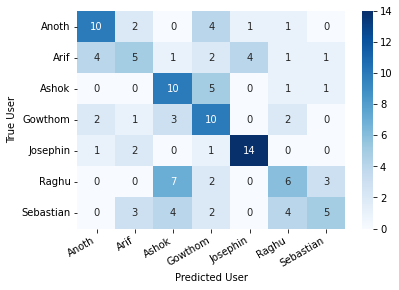

In [44]:
show_confusion_matrix(df_cm)

In [ ]:
# read model and make predictions to test data using ipywidgets
# in practice this would be trained once with a lot of participants por multilabel classification
# then you would use transfer learning to init weights of a (binary-pattern-agnostic) josephin_classifier for instance
# she would thereafter re-train the network with a few shots of pattern attempts in her device ([laptop|smartphone] with eye_tracker) and voila!
# your new security feature is ready!

# passing from binary to the same multilabel setting should not impose a problem for the execution, but what will really impose a problem is that 
# I would have an expremely unbalanced and short new dataset to re-train the nn. Can this setting work in unbalanced few-shot using transfer learning?

# (inspired by natural language inference)
# I could also translate the whole problem to a more general binary classifier; for each sample I produce two and add and extra column (["True", "False"])
# I have all the positives but to produce the negatives I can simply randomly pick a a wrong label (participant_name)
# this method would duplicate my dataset and in practice will deal better with the problems that the other setting has (balanced dataset and x2 the number of samples)
# then I would just have to be a bit smart to make the predictions and present them (translate them back to multilabel)